# Muldrow Glacier Analysis

This code will read in our geocoded and cropped SAR images over the Muldrow Glacier, sort them by dates, zoom in on our area of interest, and create a time series gif of the glacier motion. Then we import openCV and use dense and sparse optical flow, as well as particle image velocimetry to get the glacier velocities.

In [1]:
!pip install geopandas
!pip install rioxarray
!pip install rasterio
!pip install openpiv

In [2]:
!git clone https://github.com/egagli/glacier-velocity-from-sar

Cloning into 'glacier-velocity-from-sar'...
remote: Enumerating objects: 326, done.
remote: Counting objects: 100% (43/43), done.
remote: Compressing objects: 100% (43/43), done.
remote: Total 326 (delta 20), reused 0 (delta 0), pack-reused 283
Receiving objects: 100% (326/326), 857.83 MiB | 24.87 MiB/s, done.
Resolving deltas: 100% (135/135), done.
Checking out files: 100% (33/33), done.


In [3]:
!cd glacier-velocity-from-sar && git checkout eric

Checking out files: 100% (34/34), done.
Branch 'eric' set up to track remote branch 'eric' from 'origin'.
Switched to a new branch 'eric'


In [4]:
import geopandas as gpd
import os
import rasterio as rio
from rasterio import plot, mask
import matplotlib.pyplot as plt
import numpy as np
import rioxarray
import pandas as pd
from IPython.display import HTML
from matplotlib.animation import FuncAnimation

In [5]:
geo_crop_dir = '/content/glacier-velocity-from-sar/import_data/import_sar_asf_script/sar_images_geocoded_cropped'

In [6]:
muldrow = gpd.read_file('/content/glacier-velocity-from-sar/import_data/import_glacier_shapefiles_rgi/muldrow_glacier.geojson')

## Extract dates from files and sort SAR images by date

In [7]:
file_list = []
date_list = []
for file in os.listdir(geo_crop_dir):
    if file != '.ipynb_checkpoints':
        file_list.append(file)
        date = pd.to_datetime(file[14:29])
        date_list.append(date)

In [8]:
date_list.sort()
file_list.sort()

## Take the log of each SAR image and display with accompanying colorbar

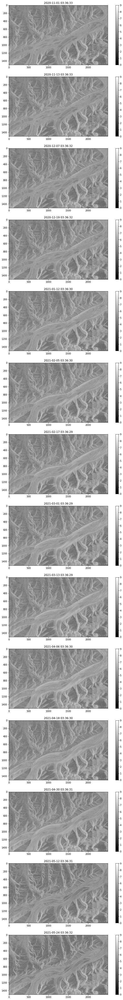

In [9]:
f,ax=plt.subplots(len(file_list),1,figsize=(12,80))
for i,file in enumerate(file_list):
    sar_image = plt.imread(f'{geo_crop_dir}/{file}')
    sar_image_log = np.log(sar_image,where=(sar_image!=0))
    color = ax[i].imshow(sar_image_log[1000:2500,1000:3500],cmap='gray',vmin=0,vmax=9)
    ax[i].set_title(date_list[i])
    f.colorbar(color,ax=ax[i])

## Create and save a gif of the SAR time series stack

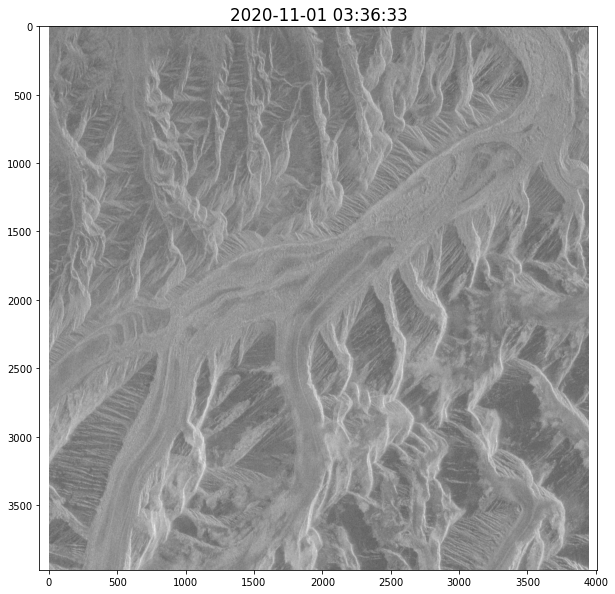

In [10]:
f,ax=plt.subplots(figsize=(10,10))
plt.rcParams.update({'font.size': 14})

sar_image = plt.imread(f'{geo_crop_dir}/{file_list[0]}')
im = ax.imshow(np.log(sar_image,where=(sar_image!=0)),cmap='gray')
ax.set_title(date_list[0])

def update(frame):
    sar_image = plt.imread(f'{geo_crop_dir}/{file_list[frame]}')
    sar_image_log = np.log(sar_image,where=(sar_image!=0))
    im.set_data(sar_image_log[1000:3000,1000:3700])
    ax.set_title(date_list[frame])
    ax.axis('equal')


ani = FuncAnimation(f, update, frames=len(file_list), blit=False, interval=300)

In [11]:
HTML(ani.to_jshtml())

In [12]:
ani.save('muldrow_timeseries_subset.gif', writer='pillow', fps=2)

In [13]:
#TODO: create notebooks to try out different approaches
# whatever way we learn in class
# look at opencv tools, for example: https://docs.opencv.org/master/d7/df3/group__imgproc__motion.html
# speckle offset tracking
# https://mudic.readthedocs.io/en/latest/examples/example.html
# for validation: https://docs.terradue.com/ellip/solutions/notebooks/examples/polar/resources/code/polarstern/04-glacier-velocity.html
# ...

# Dense Optical Flow



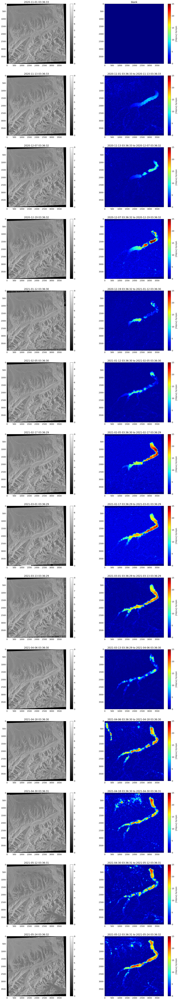

In [14]:
import glob
import cv2 as cv
import numpy as np
from tqdm import notebook
from matplotlib import pyplot as plt

dims = cv.imread(f'{geo_crop_dir}/{file_list[0]}')
first_frame = cv.imread(f'{geo_crop_dir}/{file_list[0]}',cv.IMREAD_UNCHANGED)

prev_frame = np.log(first_frame,where=(first_frame!=0))
mask = np.zeros_like(dims)
mask[..., 1] = 255
all_velocities = np.zeros((prev_frame.shape[0],prev_frame.shape[1],len(file_list)))


f,ax=plt.subplots(len(file_list),2,figsize=(23,130))
for i, filename in notebook.tqdm(enumerate(file_list)):  
    frame = cv.imread(f'{geo_crop_dir}/{filename}',cv.IMREAD_UNCHANGED)
    gray = np.log(frame,where=(frame!=0))

    colorb = ax[i,0].imshow(gray,vmin=0,vmax=9,cmap='gray')
    f.colorbar(colorb,ax=ax[i,0])
    ax[i,0].set_title(date_list[i])
    
    
    flow = cv.calcOpticalFlowFarneback(prev_frame, frame, 
                                       None,
                                       0.5, 3, 15, 3, 5, 1.1, 0)
      
    magnitude, angle = cv.cartToPolar(flow[..., 0], flow[..., 1])

    mask[..., 0] = angle * 180 / np.pi / 2
      
    mask[..., 2] = cv.normalize(magnitude, None, 0, 255, cv.NORM_MINMAX)
      
    rgb = cv.cvtColor(mask, cv.COLOR_HSV2BGR)
    if i == 0:
      delta_t = 1000000
    else:
      delta_t = date_list[i]-date_list[i-1]
      delta_t = delta_t.days
    pixel_res = 10  

    all_velocities[:,:,i] = magnitude*(pixel_res/delta_t)
    colorb2 = ax[i,1].imshow(magnitude*(pixel_res/delta_t),vmin=0,vmax=25,cmap='jet') 
    cbar = f.colorbar(colorb2,ax=ax[i,1])
    cbar.set_label('velocity [m/day]', rotation=270,labelpad=20)

    if i == 0:
      ax[i,1].set_title('blank')
    else:
      ax[i,1].set_title(f'{date_list[i-1]} to {date_list[i]}')
      
    prev_frame = frame

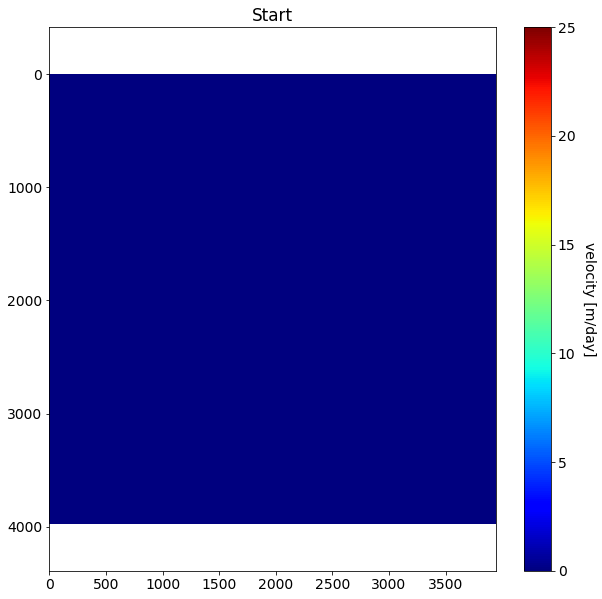

In [15]:
f,ax=plt.subplots(figsize=(10,10))
plt.rcParams.update({'font.size': 14})

im = ax.imshow(all_velocities[:,:,0],cmap='jet',vmin=0,vmax=25)
cbar = f.colorbar(im)
cbar.set_label('velocity [m/day]', rotation=270,labelpad=20)

def update(frame):

    im.set_data(all_velocities[:,:,frame])
    if frame == 0:
      ax.set_title('Start')
    else:
      ax.set_title(f'{date_list[frame-1]} to {date_list[frame]}')
    ax.axis('equal')


ani = FuncAnimation(f, update, frames=len(file_list), blit=False, interval=1000)
HTML(ani.to_jshtml())

In [16]:
ani.save('muldrow_timeseries_velocity.gif', writer='pillow', fps=1)

# Particle Image Velocimetry

In [17]:
#https://github.com/OpenPIV/openpiv-python
from openpiv import tools, pyprocess, validation, filters, scaling 

In [18]:
frame_a  = tools.imread(f'{geo_crop_dir}/{file_list[0]}')
frame_b  = tools.imread(f'{geo_crop_dir}/{file_list[1]}')

frame_a = np.log(frame_a,where=(frame_a!=0))
frame_b = np.log(frame_b,where=(frame_b!=0))

/usr/local/lib/python3.7/dist-packages/matplotlib/image.py:468: RuntimeWarning: invalid value encountered in subtract
  A_scaled -= a_min


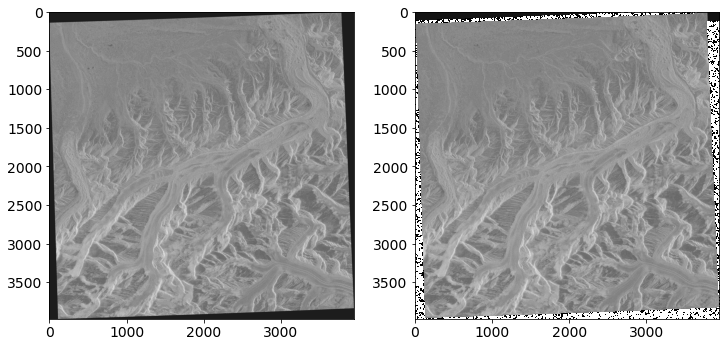

In [19]:
fig,ax = plt.subplots(1,2,figsize=(12,10))
ax[0].imshow(frame_a,cmap=plt.cm.gray,vmin=0,vmax=9)
ax[1].imshow(frame_b,cmap=plt.cm.gray,vmin=0,vmax=9)

In [20]:
winsize = 16 # pixels, interrogation window size in frame A
searchsize = 20  # pixels, search in image B
overlap = 8 # pixels, 50% overlap
dt = 1.037E6 # sec, time interval between pulses


u0, v0, sig2noise = pyprocess.extended_search_area_piv(frame_a.astype(np.int32), 
                                                       frame_b.astype(np.int32), 
                                                       window_size=winsize, 
                                                       overlap=overlap, 
                                                       dt=dt, 
                                                       search_area_size=searchsize, 
                                                       sig2noise_method='peak2peak')

In [21]:
x, y = pyprocess.get_coordinates( image_size=frame_a.shape, 
                                 search_area_size=searchsize, 
                                 overlap=overlap )

In [22]:
u1, v1, mask = validation.sig2noise_val( u0, v0, 
                                        sig2noise, 
                                        threshold = 1.05 )
# if you need more detailed look, first create a histogram of sig2noise
# plt.hist(sig2noise.flatten())
# to see where is a reasonable limit

In [23]:
# filter out outliers that are very different from the
# neighbours

u2, v2 = filters.replace_outliers( u1, v1, 
                                  method='localmean', 
                                  max_iter=1, 
                                  kernel_size=3)

In [24]:
# convert x,y to mm
# convert u,v to mm/sec

x, y, u3, v3 = scaling.uniform(x, y, u2, v2, 
                               scaling_factor = 0.1 ) # 96.52 microns/pixel

# 0,0 shall be bottom left, positive rotation rate is counterclockwise
x, y, u3, v3 = tools.transform_coordinates(x, y, u3, v3)

In [25]:
#save in the simple ASCII table format
tools.save(x, y, u3, v3, mask, 'exp1_001.txt' )

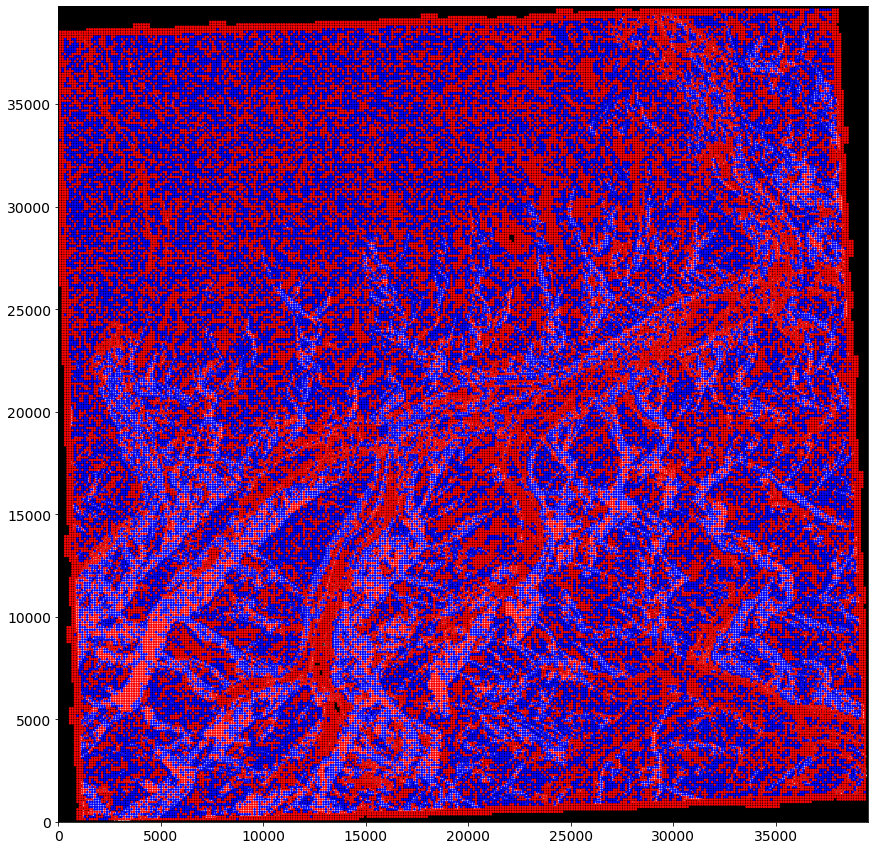

In [26]:
fig, ax = plt.subplots(figsize=(15,15))
tools.display_vector_field('exp1_001.txt', 
                           ax=ax, scaling_factor=0.1, 
                           scale=50, # scale defines here the arrow length
                           width=0.0035, # width is the thickness of the arrow
                           on_img=True, # overlay on the image
                           image_name=f'{geo_crop_dir}/{file_list[0]}');

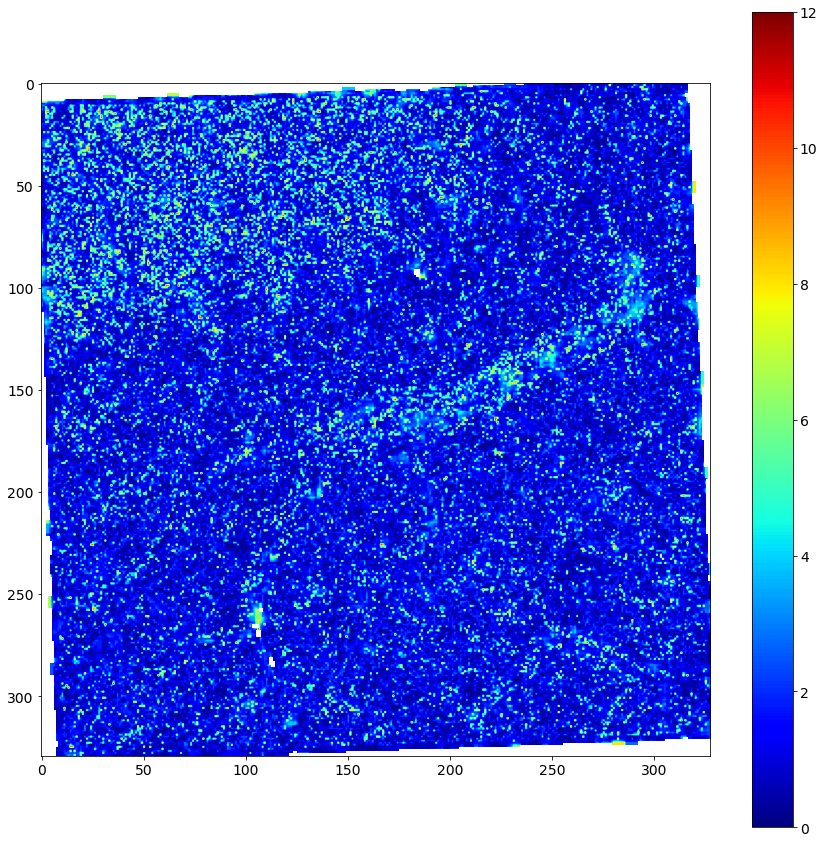

In [27]:
f,ax=plt.subplots(figsize=(15,15))
colors = ax.imshow(np.sqrt(u3**2+v3**2)*60*60*24,cmap='jet',vmin=0,vmax=12)
f.colorbar(colors)

/usr/local/lib/python3.7/dist-packages/matplotlib/image.py:468: RuntimeWarning: invalid value encountered in subtract
  A_scaled -= a_min


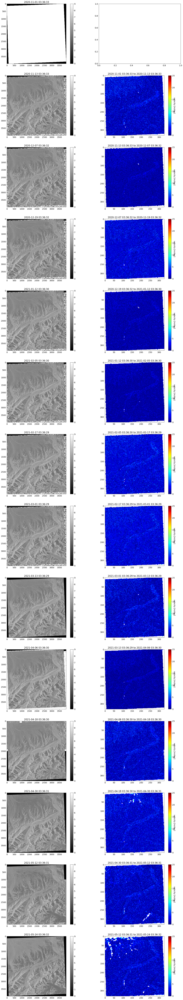

In [28]:
winsize = 16 # pixels, interrogation window size in frame A
searchsize = 20  # pixels, search in image B
overlap = 8 # pixels, 50% overlap
dt = 1.037E6 # sec, time interval between pulses

f,ax=plt.subplots(len(file_list),2,figsize=(23,130))
for i, filename in notebook.tqdm(enumerate(file_list)): 

  if i == 0:
    frame_a  = tools.imread(f'{geo_crop_dir}/{file_list[0]}')
    colorb = ax[i,0].imshow(frame_a,vmin=0,vmax=9,cmap='gray')
    f.colorbar(colorb,ax=ax[i,0])
    ax[i,0].set_title(date_list[0])
    continue

  frame_a  = tools.imread(f'{geo_crop_dir}/{file_list[i-1]}')
  frame_b  = tools.imread(f'{geo_crop_dir}/{file_list[i]}')
  frame_a = np.log(frame_a,where=(frame_a!=0))
  frame_b = np.log(frame_b,where=(frame_b!=0))  

  colorb = ax[i,0].imshow(frame_b,vmin=0,vmax=9,cmap='gray')
  f.colorbar(colorb,ax=ax[i,0])
  ax[i,0].set_title(date_list[i])


  u0, v0, sig2noise = pyprocess.extended_search_area_piv(frame_a.astype(np.int32), 
                                                       frame_b.astype(np.int32), 
                                                       window_size=winsize, 
                                                       overlap=overlap, 
                                                       dt=dt, 
                                                       search_area_size=searchsize, 
                                                       sig2noise_method='peak2peak')
  x, y = pyprocess.get_coordinates( image_size=frame_a.shape, 
                                 search_area_size=searchsize, 
                                 overlap=overlap )
  u1, v1, mask = validation.sig2noise_val( u0, v0, 
                                        sig2noise, 
                                        threshold = 1.05 )
  u2, v2 = filters.replace_outliers( u1, v1, 
                                  method='localmean', 
                                  max_iter=1, 
                                  kernel_size=3)
  x, y, u3, v3 = scaling.uniform(x, y, u2, v2, 
                               scaling_factor = 0.1 ) # 96.52 microns/pixel
  # 0,0 shall be bottom left, positive rotation rate is counterclockwise
  x, y, u3, v3 = tools.transform_coordinates(x, y, u3, v3)

  if i == 0:
    delta_t = 1000000
  else:
    delta_t = date_list[i]-date_list[i-1]
    delta_t = delta_t.days
  colorb2 = ax[i,1].imshow(np.sqrt(u3**2+v3**2)*60*60*24/(delta_t/12),vmin=0,vmax=25,cmap='jet') 
  cbar = f.colorbar(colorb2,ax=ax[i,1])
  cbar.set_label('velocity [m/day]', rotation=270)
  if i == 0:
    ax[i,1].set_title('blank')
  else:
    ax[i,1].set_title(f'{date_list[i-1]} to {date_list[i]}')    

# Sparse Optical Flow

error: ignored

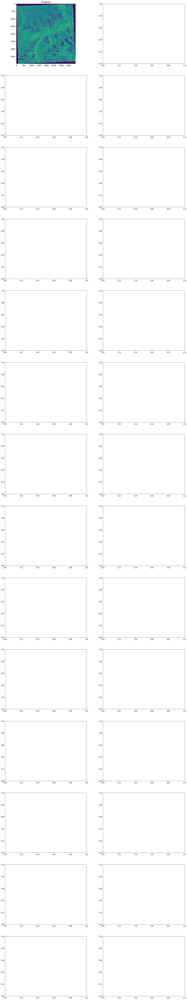

In [50]:
import glob
import warnings
import cv2 as cv
import numpy as np
from tqdm import notebook
from matplotlib import pyplot as plt
warnings.filterwarnings("ignore")

# Parameters for Shi-Tomasi corner detection
feature_params = dict(maxCorners = 30, qualityLevel = 0.01, minDistance = 10, blockSize = 10)

# Parameters for Lucas-Kanade optical flow
lk_params = dict(winSize = (15,15), maxLevel = 2, criteria = (cv.TERM_CRITERIA_EPS | cv.TERM_CRITERIA_COUNT, 10, 0.03))

# Variable for color to draw optical flow track
color = (0, 255, 0)

# ret = a boolean return value from getting the frame, first_frame = the first frame in the entire video sequence
#ret, first_frame = cap.read()
first_frame = cv.imread(f'{geo_crop_dir}/{file_list[0]}',cv.IMREAD_UNCHANGED)
# Converts frame to grayscale because we only need the luminance channel for detecting edges - less computationally expensive
prev_frame = np.log(first_frame,where=(first_frame!=0))

# Finds the strongest corners in the first frame by Shi-Tomasi method - we will track the optical flow for these corners
# https://docs.opencv.org/3.0-beta/modules/imgproc/doc/feature_detection.html#goodfeaturestotrack
prev = cv.goodFeaturesToTrack(prev_frame, mask = None, **feature_params)

# Creates an image filled with zero intensities with the same dimensions as the frame - for later drawing purposes
mask = np.zeros_like(first_frame)

f,ax=plt.subplots(len(file_list),2,figsize=(23,130))
for i, filename in notebook.tqdm(enumerate(file_list)):   
    frame = cv.imread(f'{geo_crop_dir}/{filename}',cv.IMREAD_UNCHANGED)
    gray = np.log(frame,where=(frame!=0))
    
    ax[i,0].imshow(frame)
    ax[i,0].set_title('Original')
    # ret = a boolean return value from getting the frame, frame = the current frame being projected in the video
    # ret, frame = cap.read()
    
    # Converts each frame to grayscale - we previously only converted the first frame to grayscale
    
    # Calculates sparse optical flow by Lucas-Kanade method
    # https://docs.opencv.org/3.0-beta/modules/video/doc/motion_analysis_and_object_tracking.html#calcopticalflowpyrlk
    next, status, error = cv.calcOpticalFlowPyrLK(prev_frame, gray, prev, None, **lk_params)
    
    # Selects good feature points for previous position
    good_old = prev[status == 1]
    
    # Selects good feature points for next position
    good_new = next[status == 1]
    
    # Draws the optical flow tracks
    for j, (new, old) in enumerate(zip(good_new, good_old)):
    
        # Returns a contiguous flattened array as (x, y) coordinates for new point
        a, b = new.ravel()
        
        # Returns a contiguous flattened array as (x, y) coordinates for old point
        c, d = old.ravel()
        
        # Draws line between new and old position with green color and 2 thickness
        mask = cv.line(mask, (a, b), (c, d), color, 100)
        
        # Draws filled circle (thickness of -1) at new position with green color and radius of 3
        frame = cv.circle(frame, (a, b), 3, color, -1)
    
    # Overlays the optical flow tracks on the original frame
    output = cv.add(frame, mask)
    
    # Updates previous frame
    prev_frame = gray.copy()
    
    # Updates previous good feature points
    prev = good_new.reshape(-1, 1, 2)
    
    # Opens a new window and displays the output frame
    ax[i,1].imshow(output)
    ax[i,1].set_title('Sparse')

In [45]:
prev_frame.shape

(3975, 3944)

In [46]:
gray.shape

(3975, 3944)

In [47]:
prev.shape

(1, 1, 2)